# Download dataset

In [2]:
import numpy as np
import pandas as pd
print('Numpy and Pandas are working!')
print('Numpy version: ', np.__version__)
print('Pandas version ', pd.__version__)

Numpy and Pandas are working!
Numpy version:  1.24.3
Pandas version  2.1.1


In [3]:
#store csv file of recipes into pandas data frame
recipes = pd.read_csv('recipes.csv', engine='python')

In [4]:
#store csv file of reviews into pandas data frame
reviews = pd.read_csv('reviews.csv', engine='python')

# Preprocessing

In [5]:
#check the dataset
recipes.info(), recipes.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 522517 entries, 0 to 522516
Data columns (total 28 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   RecipeId                    522517 non-null  int64  
 1   Name                        522517 non-null  object 
 2   AuthorId                    522517 non-null  int64  
 3   AuthorName                  522517 non-null  object 
 4   CookTime                    439972 non-null  object 
 5   PrepTime                    522517 non-null  object 
 6   TotalTime                   522517 non-null  object 
 7   DatePublished               522517 non-null  object 
 8   Description                 522512 non-null  object 
 9   Images                      522516 non-null  object 
 10  RecipeCategory              521766 non-null  object 
 11  Keywords                    505280 non-null  object 
 12  RecipeIngredientQuantities  522514 non-null  object 
 13  RecipeIngredie

(None, (522517, 28))

In [6]:
#check column (28 columns)
recipes.columns

Index(['RecipeId', 'Name', 'AuthorId', 'AuthorName', 'CookTime', 'PrepTime',
       'TotalTime', 'DatePublished', 'Description', 'Images', 'RecipeCategory',
       'Keywords', 'RecipeIngredientQuantities', 'RecipeIngredientParts',
       'AggregatedRating', 'ReviewCount', 'Calories', 'FatContent',
       'SaturatedFatContent', 'CholesterolContent', 'SodiumContent',
       'CarbohydrateContent', 'FiberContent', 'SugarContent', 'ProteinContent',
       'RecipeServings', 'RecipeYield', 'RecipeInstructions'],
      dtype='object')

In [7]:
recipes.head(3)

,RecipeId,Name,AuthorId,AuthorName,CookTime,PrepTime,TotalTime,DatePublished,Description,Images,...,SaturatedFatContent,CholesterolContent,SodiumContent,CarbohydrateContent,FiberContent,SugarContent,ProteinContent,RecipeServings,RecipeYield,RecipeInstructions
0,38,Low-Fat Berry Blue Frozen Dessert,1533,Dancer,PT24H,PT45M,PT24H45M,1999-08-09T21:46:00Z,Make and share this Low-Fat Berry Blue Frozen ...,"c(""https://img.sndimg.com/food/image/upload/w_...",...,1.3,8.0,29.8,37.1,3.6,30.2,3.2,4.0,NaN,"c(""Toss 2 cups berries with sugar."", ""Let stan..."
1,39,Biryani,1567,elly9812,PT25M,PT4H,PT4H25M,1999-08-29T13:12:00Z,Make and share this Biryani recipe from Food.com.,"c(""https://img.sndimg.com/food/image/upload/w_...",...,16.6,372.8,368.4,84.4,9.0,20.4,63.4,6.0,NaN,"c(""Soak saffron in warm milk for 5 minutes and..."
2,40,Best Lemonade,1566,Stephen Little,PT5M,PT30M,PT35M,1999-09-05T19:52:00Z,This is from one of my first Good House Keepi...,"c(""https://img.sndimg.com/food/image/upload/w_...",...,0.0,0.0,1.8,81.5,0.4,77.2,0.3,4.0,NaN,"c(""Into a 1 quart Jar with tight fitting lid, ..."


In [8]:
#drop column that is not needed

#list of columns to drop
columns_to_drop = [
    'RecipeCategory', 'Keywords', 'AuthorName', 'DatePublished', 'Description',
    'Calories', 'FatContent', 'SaturatedFatContent', 'CholesterolContent', 
    'SodiumContent', 'ProteinContent', 'CarbohydrateContent', 'FiberContent', 
    'SugarContent', 'RecipeServings', 'RecipeYield'
]

#drop the columns
recipes = recipes.drop(columns=columns_to_drop, axis=1)

print('succesfully drop columns') #dh drop dah tau, kena run sekali je

succesfully drop columns


In [9]:
#x yah run ni, sekali je sbb drop, tercicir nak drop author id
recipes = recipes.drop(['AuthorId'], axis=1)
print('drop author id')

drop author id


In [10]:
recipes.info(), recipes.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 522517 entries, 0 to 522516
Data columns (total 11 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   RecipeId                    522517 non-null  int64  
 1   Name                        522517 non-null  object 
 2   CookTime                    439972 non-null  object 
 3   PrepTime                    522517 non-null  object 
 4   TotalTime                   522517 non-null  object 
 5   Images                      522516 non-null  object 
 6   RecipeIngredientQuantities  522514 non-null  object 
 7   RecipeIngredientParts       522517 non-null  object 
 8   AggregatedRating            269294 non-null  float64
 9   ReviewCount                 275028 non-null  float64
 10  RecipeInstructions          522517 non-null  object 
dtypes: float64(2), int64(1), object(8)
memory usage: 43.9+ MB


(None, (522517, 11))

In [11]:
recipes.head(3)

,RecipeId,Name,CookTime,PrepTime,TotalTime,Images,RecipeIngredientQuantities,RecipeIngredientParts,AggregatedRating,ReviewCount,RecipeInstructions
0,38,Low-Fat Berry Blue Frozen Dessert,PT24H,PT45M,PT24H45M,"c(""https://img.sndimg.com/food/image/upload/w_...","c(""4"", ""1/4"", ""1"", ""1"")","c(""blueberries"", ""granulated sugar"", ""vanilla ...",4.5,4.0,"c(""Toss 2 cups berries with sugar."", ""Let stan..."
1,39,Biryani,PT25M,PT4H,PT4H25M,"c(""https://img.sndimg.com/food/image/upload/w_...","c(""1"", ""4"", ""2"", ""2"", ""8"", ""1/4"", ""8"", ""1/2"", ...","c(""saffron"", ""milk"", ""hot green chili peppers""...",3.0,1.0,"c(""Soak saffron in warm milk for 5 minutes and..."
2,40,Best Lemonade,PT5M,PT30M,PT35M,"c(""https://img.sndimg.com/food/image/upload/w_...","c(""1 1/2"", ""1"", NA, ""1 1/2"", NA, ""3/4"")","c(""sugar"", ""lemons, rind of"", ""lemon, zest of""...",4.5,10.0,"c(""Into a 1 quart Jar with tight fitting lid, ..."


In [12]:
#preprocessing for CookTime, PrepTime, TotalTime, Images, RecipeIngredientQuantities, RecipeIngredientParts, RecipeInstructions
recipes.CookTime[0], recipes.PrepTime[0], recipes.TotalTime[0]

('PT24H', 'PT45M', 'PT24H45M')

In [13]:
recipes.Images[0]

'c("https://img.sndimg.com/food/image/upload/w_555,h_416,c_fit,fl_progressive,q_95/v1/img/recipes/38/YUeirxMLQaeE1h3v3qnM_229%20berry%20blue%20frzn%20dess.jpg", "https://img.sndimg.com/food/image/upload/w_555,h_416,c_fit,fl_progressive,q_95/v1/img/recipes/38/AFPDDHATWzQ0b1CDpDAT_255%20berry%20blue%20frzn%20dess.jpg", "https://img.sndimg.com/food/image/upload/w_555,h_416,c_fit,fl_progressive,q_95/v1/img/recipes/38/UYgf9nwMT2SGGJCuzILO_228%20berry%20blue%20frzn%20dess.jpg", "https://img.sndimg.com/food/image/upload/w_555,h_416,c_fit,fl_progressive,q_95/v1/img/recipes/38/PeBMJN2TGSaYks2759BA_20140722_202142.jpg", \n"https://img.sndimg.com/food/image/upload/w_555,h_416,c_fit,fl_progressive,q_95/v1/img/recipes/38/picuaETeN.jpg", "https://img.sndimg.com/food/image/upload/w_555,h_416,c_fit,fl_progressive,q_95/v1/img/recipes/38/pictzvxW5.jpg")'

In [14]:
recipes.RecipeIngredientQuantities[0]

'c("4", "1/4", "1", "1")'

In [15]:
recipes.RecipeIngredientParts[0]

'c("blueberries", "granulated sugar", "vanilla yogurt", "lemon juice")'

In [16]:
recipes.RecipeInstructions[0]

'c("Toss 2 cups berries with sugar.", "Let stand for 45 minutes, stirring occasionally.", "Transfer berry-sugar mixture to food processor.", "Add yogurt and process until smooth.", "Strain through fine sieve. Pour into baking pan (or transfer to ice cream maker and process according to manufacturers\' directions). Freeze uncovered until edges are solid but centre is soft.  Transfer to processor and blend until smooth again.", "Return to pan and freeze until edges are solid.", "Transfer to processor and blend until smooth again.", \n"Fold in remaining 2 cups of blueberries.", "Pour into plastic mold and freeze overnight. Let soften slightly to serve.")'

In [17]:
recipes.isnull().sum()

RecipeId                           0
Name                               0
CookTime                       82545
PrepTime                           0
TotalTime                          0
Images                             1
RecipeIngredientQuantities         3
RecipeIngredientParts              0
AggregatedRating              253223
ReviewCount                   247489
RecipeInstructions                 0
dtype: int64

In [18]:
#imputation- fill in the missing values with some numbers/NA

def replaceNullValue(column):
    j =0
    for i in column:
        if(str(i) == 'nan'):
            column[j] = 'NA'
        j+=1
    return column

In [19]:
replaceNullValue(recipes.CookTime)

C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[j] = 'NA'
C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[j] = 'NA'
C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[j] = 'NA'
C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.

0         PT24H
1         PT25M
2          PT5M
3         PT20M
4         PT30M
          ...  
522512    PT35M
522513     PT3H
522514     PT3H
522515       NA
522516    PT25M
Name: CookTime, Length: 522517, dtype: object

In [20]:
recipes['CookTime'].isnull().sum()

0

In [21]:
#Remove word 'PT' in CookTime, PrepTime, and TotalTime columns
columns_to_update = ['CookTime', 'PrepTime', 'TotalTime']

for column in columns_to_update:
    recipes[column] = recipes[column].str.replace('PT', '', regex=False)

# Display updated columns to verify the changes
print(recipes[['CookTime', 'PrepTime', 'TotalTime']].head())


  CookTime PrepTime TotalTime
0      24H      45M    24H45M
1      25M       4H     4H25M
2       5M      30M       35M
3      20M      24H    24H20M
4      30M      20M       50M


In [22]:
recipes.head()

,RecipeId,Name,CookTime,PrepTime,TotalTime,Images,RecipeIngredientQuantities,RecipeIngredientParts,AggregatedRating,ReviewCount,RecipeInstructions
0,38,Low-Fat Berry Blue Frozen Dessert,24H,45M,24H45M,"c(""https://img.sndimg.com/food/image/upload/w_...","c(""4"", ""1/4"", ""1"", ""1"")","c(""blueberries"", ""granulated sugar"", ""vanilla ...",4.5,4.0,"c(""Toss 2 cups berries with sugar."", ""Let stan..."
1,39,Biryani,25M,4H,4H25M,"c(""https://img.sndimg.com/food/image/upload/w_...","c(""1"", ""4"", ""2"", ""2"", ""8"", ""1/4"", ""8"", ""1/2"", ...","c(""saffron"", ""milk"", ""hot green chili peppers""...",3.0,1.0,"c(""Soak saffron in warm milk for 5 minutes and..."
2,40,Best Lemonade,5M,30M,35M,"c(""https://img.sndimg.com/food/image/upload/w_...","c(""1 1/2"", ""1"", NA, ""1 1/2"", NA, ""3/4"")","c(""sugar"", ""lemons, rind of"", ""lemon, zest of""...",4.5,10.0,"c(""Into a 1 quart Jar with tight fitting lid, ..."
3,41,Carina's Tofu-Vegetable Kebabs,20M,24H,24H20M,"c(""https://img.sndimg.com/food/image/upload/w_...","c(""12"", ""1"", ""2"", ""1"", ""10"", ""1"", ""3"", ""2"", ""2...","c(""extra firm tofu"", ""eggplant"", ""zucchini"", ""...",4.5,2.0,"c(""Drain the tofu, carefully squeezing out exc..."
4,42,Cabbage Soup,30M,20M,50M,"""https://img.sndimg.com/food/image/upload/w_55...","c(""46"", ""4"", ""1"", ""2"", ""1"")","c(""plain tomato juice"", ""cabbage"", ""onion"", ""c...",4.5,11.0,"c(""Mix everything together and bring to a boil..."


In [23]:
recipes.isnull().sum()

RecipeId                           0
Name                               0
CookTime                           0
PrepTime                           0
TotalTime                          0
Images                             1
RecipeIngredientQuantities         3
RecipeIngredientParts              0
AggregatedRating              253223
ReviewCount                   247489
RecipeInstructions                 0
dtype: int64

In [24]:
# drop rows where 'Images' column has null values
recipes = recipes.dropna(subset=['Images'])

recipes.isnull().sum()

RecipeId                           0
Name                               0
CookTime                           0
PrepTime                           0
TotalTime                          0
Images                             0
RecipeIngredientQuantities         3
RecipeIngredientParts              0
AggregatedRating              253223
ReviewCount                   247489
RecipeInstructions                 0
dtype: int64

In [25]:
replaceNullValue(recipes.RecipeIngredientQuantities)

C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[j] = 'NA'
C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[j] = 'NA'


0                                   c("4", "1/4", "1", "1")
1         c("1", "4", "2", "2", "8", "1/4", "8", "1/2", ...
2                   c("1 1/2", "1", NA, "1 1/2", NA, "3/4")
3         c("12", "1", "2", "1", "10", "1", "3", "2", "2...
4                               c("46", "4", "1", "2", "1")
                                ...                        
522512    c("3", "1/2", "1/2", "1/4", "1/4", "1", "1/4",...
522513         c("9", "2", "4", "2", "1/3", "3 1/2", "1/3")
522514                  c("3", "3", "1/2", "1/2", "2", "2")
522515             c("4", "1/4", "1", "1/2", "8 1/2", "40")
522516    c("6 -7", "1", "1/4", "1", "2", "1/2", "1", "1...
Name: RecipeIngredientQuantities, Length: 522516, dtype: object

In [26]:
recipes.isnull().sum()

RecipeId                           0
Name                               0
CookTime                           0
PrepTime                           0
TotalTime                          0
Images                             0
RecipeIngredientQuantities         2
RecipeIngredientParts              0
AggregatedRating              253223
ReviewCount                   247489
RecipeInstructions                 0
dtype: int64

### Formatting data values of recipes.csv

In [27]:
# Splitting data over '", "' and ignoring the starting 'c("' and ending '")' for all
# For NA values in keywords column, replacing it by "NA"
# For character(0) value in Images column, replacing it with "character(0)"
# Ignoring any "\n" occurrence, 
# For some special cases in Images column which begin with '"http' instead of more common'c("' and end normally instead of '")', 
# making it to read characters from 1st index(character h) only and ignoring just the last '"' by the if-else conditional
def reformatColumns(columnTitle):
  L = []
  for i in columnTitle:
    if(type(i) == str):
      i = i.replace("NA", '"NA"')
      i = i.replace("character(0)", 'c("character(0)")')
      i = i.replace("\n", "")
      if(i[0:5] == '"http'):
        L.append([i[1:-1]]) 
      else:
        L.append(i[3:-2].split('", "')) 
    else:
      L.append([])
  return L

In [28]:
# As there is no need of splitting, replacing some values and appending it to the list to be returned for each recipe
def reformatRecipe(recipe):
  L = []
  for i in recipe:
    i = i.replace("\n", "")
    i = i.replace('.", "', '. ')
    i = i.replace('c("', '')
    i = i.replace('")', '')
    L.append(i)
  return L

In [29]:
recipes.Images = reformatColumns(recipes.Images)

In [30]:
recipes.Images.head()

0    [https://img.sndimg.com/food/image/upload/w_55...
1    [https://img.sndimg.com/food/image/upload/w_55...
2    [https://img.sndimg.com/food/image/upload/w_55...
3    [https://img.sndimg.com/food/image/upload/w_55...
4    [https://img.sndimg.com/food/image/upload/w_55...
Name: Images, dtype: object

In [31]:
recipes.head()

,RecipeId,Name,CookTime,PrepTime,TotalTime,Images,RecipeIngredientQuantities,RecipeIngredientParts,AggregatedRating,ReviewCount,RecipeInstructions
0,38,Low-Fat Berry Blue Frozen Dessert,24H,45M,24H45M,[https://img.sndimg.com/food/image/upload/w_55...,"c(""4"", ""1/4"", ""1"", ""1"")","c(""blueberries"", ""granulated sugar"", ""vanilla ...",4.5,4.0,"c(""Toss 2 cups berries with sugar."", ""Let stan..."
1,39,Biryani,25M,4H,4H25M,[https://img.sndimg.com/food/image/upload/w_55...,"c(""1"", ""4"", ""2"", ""2"", ""8"", ""1/4"", ""8"", ""1/2"", ...","c(""saffron"", ""milk"", ""hot green chili peppers""...",3.0,1.0,"c(""Soak saffron in warm milk for 5 minutes and..."
2,40,Best Lemonade,5M,30M,35M,[https://img.sndimg.com/food/image/upload/w_55...,"c(""1 1/2"", ""1"", NA, ""1 1/2"", NA, ""3/4"")","c(""sugar"", ""lemons, rind of"", ""lemon, zest of""...",4.5,10.0,"c(""Into a 1 quart Jar with tight fitting lid, ..."
3,41,Carina's Tofu-Vegetable Kebabs,20M,24H,24H20M,[https://img.sndimg.com/food/image/upload/w_55...,"c(""12"", ""1"", ""2"", ""1"", ""10"", ""1"", ""3"", ""2"", ""2...","c(""extra firm tofu"", ""eggplant"", ""zucchini"", ""...",4.5,2.0,"c(""Drain the tofu, carefully squeezing out exc..."
4,42,Cabbage Soup,30M,20M,50M,[https://img.sndimg.com/food/image/upload/w_55...,"c(""46"", ""4"", ""1"", ""2"", ""1"")","c(""plain tomato juice"", ""cabbage"", ""onion"", ""c...",4.5,11.0,"c(""Mix everything together and bring to a boil..."


In [32]:
recipes.RecipeIngredientParts = reformatColumns(recipes.RecipeIngredientParts)

In [33]:
recipes.RecipeIngredientParts.head()

0    [blueberries, granulated sugar, vanilla yogurt...
1    [saffron, milk, hot green chili peppers, onion...
2    [sugar, lemons, rind of, lemon, zest of, fresh...
3    [extra firm tofu, eggplant, zucchini, mushroom...
4    [plain tomato juice, cabbage, onion, carrots, ...
Name: RecipeIngredientParts, dtype: object

In [34]:
recipes.RecipeIngredientQuantities = reformatColumns(recipes.RecipeIngredientQuantities)

In [35]:
recipes.RecipeIngredientQuantities.head()

0                                       [4, 1/4, 1, 1]
1    [1, 4, 2, 2, 8, 1/4, 8, 1/2, 1, 1, 1/4, 1/4, 1...
2                       [1 1/2, 1, NA, 1 1/2, NA, 3/4]
3    [12, 1, 2, 1, 10, 1, 3, 2, 2, 2, 1, 2, 1/2, 1/...
4                                     [46, 4, 1, 2, 1]
Name: RecipeIngredientQuantities, dtype: object

In [36]:
recipes.RecipeInstructions = reformatRecipe(recipes.RecipeInstructions)

In [37]:
recipes.RecipeInstructions.head()

0    Toss 2 cups berries with sugar. Let stand for ...
1    Soak saffron in warm milk for 5 minutes and pu...
2    Into a 1 quart Jar with tight fitting lid, put...
3    Drain the tofu, carefully squeezing out excess...
4    Mix everything together and bring to a boil. R...
Name: RecipeInstructions, dtype: object

In [38]:
recipes.loc[0]

RecipeId                                                                     38
Name                                          Low-Fat Berry Blue Frozen Dessert
CookTime                                                                    24H
PrepTime                                                                    45M
TotalTime                                                                24H45M
Images                        [https://img.sndimg.com/food/image/upload/w_55...
RecipeIngredientQuantities                                       [4, 1/4, 1, 1]
RecipeIngredientParts         [blueberries, granulated sugar, vanilla yogurt...
AggregatedRating                                                            4.5
ReviewCount                                                                 4.0
RecipeInstructions            Toss 2 cups berries with sugar. Let stand for ...
Name: 0, dtype: object

In [39]:
recipes.head()

,RecipeId,Name,CookTime,PrepTime,TotalTime,Images,RecipeIngredientQuantities,RecipeIngredientParts,AggregatedRating,ReviewCount,RecipeInstructions
0,38,Low-Fat Berry Blue Frozen Dessert,24H,45M,24H45M,[https://img.sndimg.com/food/image/upload/w_55...,"[4, 1/4, 1, 1]","[blueberries, granulated sugar, vanilla yogurt...",4.5,4.0,Toss 2 cups berries with sugar. Let stand for ...
1,39,Biryani,25M,4H,4H25M,[https://img.sndimg.com/food/image/upload/w_55...,"[1, 4, 2, 2, 8, 1/4, 8, 1/2, 1, 1, 1/4, 1/4, 1...","[saffron, milk, hot green chili peppers, onion...",3.0,1.0,Soak saffron in warm milk for 5 minutes and pu...
2,40,Best Lemonade,5M,30M,35M,[https://img.sndimg.com/food/image/upload/w_55...,"[1 1/2, 1, NA, 1 1/2, NA, 3/4]","[sugar, lemons, rind of, lemon, zest of, fresh...",4.5,10.0,"Into a 1 quart Jar with tight fitting lid, put..."
3,41,Carina's Tofu-Vegetable Kebabs,20M,24H,24H20M,[https://img.sndimg.com/food/image/upload/w_55...,"[12, 1, 2, 1, 10, 1, 3, 2, 2, 2, 1, 2, 1/2, 1/...","[extra firm tofu, eggplant, zucchini, mushroom...",4.5,2.0,"Drain the tofu, carefully squeezing out excess..."
4,42,Cabbage Soup,30M,20M,50M,[https://img.sndimg.com/food/image/upload/w_55...,"[46, 4, 1, 2, 1]","[plain tomato juice, cabbage, onion, carrots, ...",4.5,11.0,Mix everything together and bring to a boil. R...


# Reviews.csv

In [40]:
#check reviews dataset
reviews.info(), reviews.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1401982 entries, 0 to 1401981
Data columns (total 8 columns):
 #   Column         Non-Null Count    Dtype 
---  ------         --------------    ----- 
 0   ReviewId       1401982 non-null  int64 
 1   RecipeId       1401982 non-null  int64 
 2   AuthorId       1401982 non-null  int64 
 3   AuthorName     1401982 non-null  object
 4   Rating         1401982 non-null  int64 
 5   Review         1401768 non-null  object
 6   DateSubmitted  1401982 non-null  object
 7   DateModified   1401982 non-null  object
dtypes: int64(4), object(4)
memory usage: 85.6+ MB


(None, (1401982, 8))

In [41]:
reviews.head()

,ReviewId,RecipeId,AuthorId,AuthorName,Rating,Review,DateSubmitted,DateModified
0,2,992,2008,gayg msft,5,better than any you can get at a restaurant!,2000-01-25T21:44:00Z,2000-01-25T21:44:00Z
1,7,4384,1634,Bill Hilbrich,4,"I cut back on the mayo, and made up the differ...",2001-10-17T16:49:59Z,2001-10-17T16:49:59Z
2,9,4523,2046,Gay Gilmore ckpt,2,i think i did something wrong because i could ...,2000-02-25T09:00:00Z,2000-02-25T09:00:00Z
3,13,7435,1773,Malarkey Test,5,easily the best i have ever had. juicy flavor...,2000-03-13T21:15:00Z,2000-03-13T21:15:00Z
4,14,44,2085,Tony Small,5,An excellent dish.,2000-03-28T12:51:00Z,2000-03-28T12:51:00Z


In [42]:
#statistics of the numerical data
reviews.describe()

,ReviewId,RecipeId,AuthorId,Rating
count,1.401982e+06,1.401982e+06,1.401982e+06,1.401982e+06
mean,8.179739e+05,1.526412e+05,1.558638e+08,4.407951e+00
std,5.280821e+05,1.301112e+05,5.305111e+08,1.272012e+00
min,2.000000e+00,3.800000e+01,1.533000e+03,0.000000e+00
25%,3.743862e+05,4.703875e+04,1.336800e+05,4.000000e+00
50%,7.717805e+05,1.093270e+05,3.305450e+05,5.000000e+00
75%,1.204126e+06,2.318768e+05,8.183590e+05,5.000000e+00
max,2.090347e+06,5.412980e+05,2.002902e+09,5.000000e+00


In [43]:
reviews.isnull().sum()

ReviewId           0
RecipeId           0
AuthorId           0
AuthorName         0
Rating             0
Review           214
DateSubmitted      0
DateModified       0
dtype: int64

In [44]:
# drop column date
reviews=reviews[['ReviewId','RecipeId','AuthorId','AuthorName','Rating','Review']]

In [45]:
# Checking the shape of dataframe after drop 2 columns from intial 8
reviews.shape

(1401982, 6)

In [46]:
#since review have null values, we call back method replaceNullValue to recplace with 'NA'
replaceNullValue(reviews.Review)

C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[j] = 'NA'
C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[j] = 'NA'
C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[j] = 'NA'
C:\Users\HP\AppData\Local\Temp\ipykernel_24060\3925389587.

0               better than any you can get at a restaurant!
1          I cut back on the mayo, and made up the differ...
2          i think i did something wrong because i could ...
3          easily the best i have ever had.  juicy flavor...
4                                         An excellent dish.
                                 ...                        
1401977    I was disappointed. I couldn't wait to make th...
1401978    Nothing to drain. And I don’t heat up the liqu...
1401979    Good base recipe for someone to start with. I ...
1401980    Thank you so much for this amazing recipe! I l...
1401981    I can't say enough about this recipe.... the b...
Name: Review, Length: 1401982, dtype: object

In [47]:
reviews['Review'].isnull().sum()

0

# Analyze Data

In [48]:
# find max and min ratings
reviews['Rating'].min(), reviews['Rating'].max()

(0, 5)

C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\HP\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

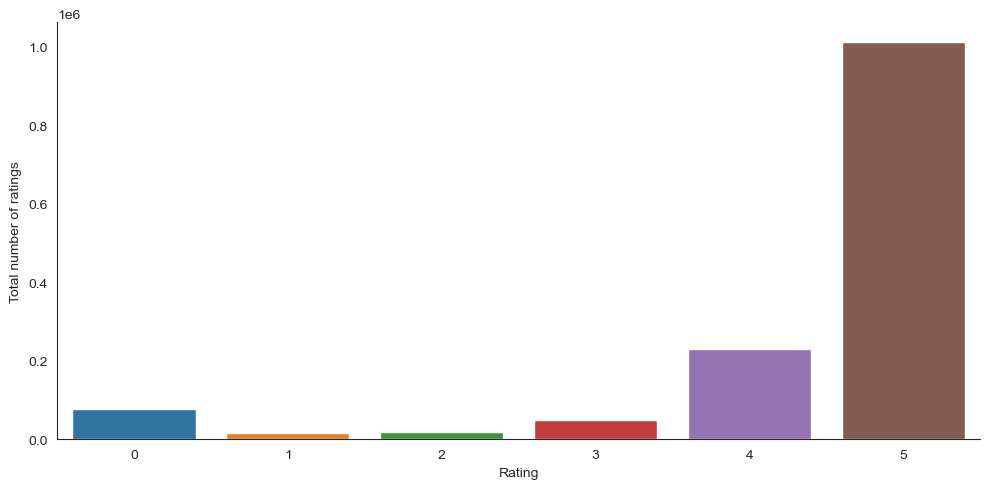

In [49]:
# check rating disctribution in range of 0-5
import seaborn as sns
import matplotlib.pyplot as plt

with sns.axes_style('white'):
    g = sns.catplot(x="Rating", data=reviews, aspect=2.0, kind='count')
    g.set_ylabels("Total number of ratings")
    plt.show()

In [50]:
print("\nTotal no of ratings :", reviews.shape[0])
print("Total No of authors   :", len(np.unique(reviews.AuthorId)))
print("Total No of recipes  :", len(np.unique(reviews.RecipeId)))


Total no of ratings : 1401982
Total No of authors   : 271907
Total No of recipes  : 271678


271,907 users rated 271,678 recipes. But we need to select the users that rate a significant num of recipes

In [51]:
#select authors who have at least rated more than 100 recipes

#groupby method to group authors based on their rating counts
reviews.groupby('AuthorId')['Rating'].count().sort_values(ascending=False)

AuthorId
424680        8842
37449         6605
383346        5438
128473        4693
169430        4586
              ... 
1505829          1
1505866          1
1505869          1
1505873          1
2002901938       1
Name: Rating, Length: 271907, dtype: int64

In [52]:
#calc the density matrix, keeping only the authors who have rated more than 100 recipes
counts = reviews['AuthorId'].value_counts()
valueReviews = reviews[reviews['AuthorId'].isin(counts[counts >= 100].index)]
valueReviews.shape 

(652022, 6)

In [53]:
valueReviews.reset_index(inplace = True, drop = True)

In [54]:
valueReviews.head()

,ReviewId,RecipeId,AuthorId,AuthorName,Rating,Review
0,47,780,2312,Gay Gilmore,5,This was delicious.\r\n
1,53,51964,2312,Gay Gilmore,5,This dish was lovely. All my guests complimen...
2,66,3862,2312,Gay Gilmore,5,I added curry powder to jazz them up.
3,67,4397,2312,Gay Gilmore,5,Everyone loves it.\r\n
4,71,1232,2312,Gay Gilmore,4,"It was good, it just tasted a little too tomat..."


In [55]:
valueReviews.groupby('AuthorId')['Rating'].count().sort_values(ascending=False)

AuthorId
424680    8842
37449     6605
383346    5438
128473    4693
169430    4586
          ... 
508148     100
482812     100
209743     100
215829     100
534623     100
Name: Rating, Length: 1735, dtype: int64

The pivot() function produces pivot table based on 3 columns of the DataFrame.

In [56]:
finalRatingsMatrix = valueReviews.pivot(index = 'AuthorId', columns ='RecipeId', values = 'Rating').fillna(0)
finalRatingsMatrix.shape

(1735, 208933)

In [57]:
# shape of finalRatingMatrix can be verified as (indexes = unique values in 'AuthorId', and cols = unique values in RecipeId)
valueReviews['AuthorId'].value_counts().shape

(1735,)

In [58]:
# Have a look at the final ratings matrix formed by the pivot function
finalRatingsMatrix

RecipeId,38,40,41,42,44,45,46,47,49,52,...,540590,540594,540622,540664,540682,540716,540717,540731,540876,541030
AuthorId,,,,,,,,,,,,,,,,,,,,,
1533,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1535,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2310,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2312,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3288,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2001102678,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2001112113,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2001297534,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [59]:
# Density of this matrix can be calculated by dividing the no. of ratings it has currently by the no. of ratings it could have had(its shape)
givenNumOfRatings = np.count_nonzero(finalRatingsMatrix)
givenNumOfRatings

640295

In [60]:
possibleNumOfRatings = finalRatingsMatrix.shape[0] * finalRatingsMatrix.shape[1]
possibleNumOfRatings

362498755

In [61]:
densityOfRatingsMatrix = (givenNumOfRatings/possibleNumOfRatings)
densityOfRatingsMatrix *= 100
print ('densityOfRatingsMatrix: {:4.2f}%'.format(densityOfRatingsMatrix))

densityOfRatingsMatrix: 0.18%


In [62]:
# finalRatingsMatrix has users as indices and products as columns.
# To get a matrix with one row per 'Recipe' and one column per 'Author'
finalRatingsMatrixAfterTranspose = finalRatingsMatrix.transpose()
finalRatingsMatrixAfterTranspose

AuthorId,1533,1535,2310,2312,3288,4291,4439,4470,4740,5060,...,2597942,1800054678,1802849661,2000431901,2000498330,2001102678,2001112113,2001297534,2001362355,2002256447
RecipeId,,,,,,,,,,,,,,,,,,,,,
38,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
44,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
540716,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
540717,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
540731,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# Recommender based on popularity

As the popular recipes are "popular" for a reason, it usually provides good recommendations, generally interesting for most people.
Not take into account an individual user's preference

These recipes would be featured on the home page of the application making sure that it caters to a new user coming on the application for the first time! 

In [63]:
#find the recipes that have highest number of ratings and reviews

highestRatedRecipes = recipes.loc[(recipes.AggregatedRating) == 5.0] 
highestRatedRecipes.shape

(174515, 11)

174k recipes with highest rating

In [64]:
#get maximum number of reviews
highestReviewedRecipes = recipes.loc[(recipes.ReviewCount) == 3063] 
highestReviewedRecipes.shape

(1, 11)

In [65]:
#finding the most favorite(in terms of ratings) and most popular(in terms of reviews) recipes. sum() factor takes into account both the rating value factor(favoriteness) and the rating count factor(popularity).
mostFavAndPopularRecipe = (reviews.groupby('RecipeId')[['Rating']].sum().sort_values('Rating', ascending=False).reset_index())
mostFavAndPopularRecipe

,RecipeId,Rating
0,45809,12478
1,2886,9204
2,27208,6911
3,39087,6767
4,89204,6689
...,...,...
271673,367965,0
271674,93550,0
271675,327907,0
271676,309426,0


In [66]:
# looking at the top recipe in the list
recipes.loc[recipes['RecipeId'] == 45809]

,RecipeId,Name,CookTime,PrepTime,TotalTime,Images,RecipeIngredientQuantities,RecipeIngredientParts,AggregatedRating,ReviewCount,RecipeInstructions
41924,45809,Bourbon Chicken,20M,15M,35M,[https://img.sndimg.com/food/image/upload/w_55...,"[2, 1 -2, 1, 1/4, 3/4, 1/4, 1/3, 2, 1, 1/2, 1/3]","[boneless chicken breasts, olive oil, garlic c...",5.0,3063.0,Editor's Note: Named Bourbon Chicken because ...


In [67]:
# merge this with recipes df
popularRecipes = pd.merge(mostFavAndPopularRecipe, recipes, on='RecipeId')

# drop rating column, because aggreated rating already have
popularRecipes.drop("Rating", axis = 1, inplace = True)

print('succesfuly merge ! ')

succesfuly merge ! 


In [68]:
popularRecipes.head(20)

,RecipeId,Name,CookTime,PrepTime,TotalTime,Images,RecipeIngredientQuantities,RecipeIngredientParts,AggregatedRating,ReviewCount,RecipeInstructions
0,45809,Bourbon Chicken,20M,15M,35M,[https://img.sndimg.com/food/image/upload/w_55...,"[2, 1 -2, 1, 1/4, 3/4, 1/4, 1/3, 2, 1, 1/2, 1/3]","[boneless chicken breasts, olive oil, garlic c...",5.0,3063.0,Editor's Note: Named Bourbon Chicken because ...
1,2886,Best Banana Bread,1H,10M,1H10M,[https://img.sndimg.com/food/image/upload/w_55...,"[1/2, 1, 2, 3, 1 1/2, 1, 1/2, 1/2]","[butter, granulated sugar, eggs, bananas, all-...",5.0,2273.0,Remove odd pots and pans from oven. Preheat ov...
2,27208,To Die for Crock Pot Roast,9H,5M,9H5M,[https://img.sndimg.com/food/image/upload/w_55...,"[1, 1, 1, 1, 1/2]","[beef roast, water]",5.0,1692.0,Place beef roast in crock pot. Mix the dried m...
3,39087,Creamy Cajun Chicken Pasta,15M,10M,25M,[https://img.sndimg.com/food/image/upload/w_55...,"[2, 4, 2, 2, 1, 1/2, 2, 1/4, 1/4, 1/8, 1/8, 1/4]","[boneless skinless chicken breast halves, ling...",5.0,1586.0,Place chicken and Cajun seasoning in a bowl an...
4,89204,Crock-Pot Chicken With Black Beans &amp; Cream...,4H,3M,4H3M,[https://img.sndimg.com/food/image/upload/w_55...,"[4 -5, 1, 1, 1, 1]","[boneless chicken breasts, black beans, corn, ...",4.5,1657.0,"Take 4-5 frozen, yes, frozen, boneless chicken..."
5,35813,Oatmeal Raisin Cookies,11M,15M,26M,[https://img.sndimg.com/food/image/upload/w_55...,"[2, 1, 1, 1, 1, 1, 1, 2, 2, 3, 1 1/2]","[all-purpose flour, baking soda, baking powder...",5.0,1410.0,Preheat oven to 350°. Whisk dry ingredients; s...
6,67256,Best Ever Banana Cake With Cream Cheese Frosting,1H,15M,1H15M,[https://img.sndimg.com/food/image/upload/w_55...,"[1 1/2, 2, 3, 1 1/2, 1/4, 3/4, 2 1/8, 3, 2, 1 ...","[bananas, lemon juice, flour, baking soda, sal...",5.0,1409.0,Preheat oven to 275°F (135C). Grease and flour...
7,22782,Jo Mama's World Famous Spaghetti,1H,20M,1H20M,[https://img.sndimg.com/food/image/upload/w_55...,"[2, 1, 3 -4, 1, 2, 2, 2, 3, 2, 1 1/2, 1, 1/4 -...","[Italian sausage, onion, garlic cloves, diced ...",5.0,1326.0,"In large, heavy stockpot, brown Italian sausag..."
8,54257,"Yes, Virginia There is a Great Meatloaf",1H,20M,1H20M,[https://img.sndimg.com/food/image/upload/w_55...,"[1 1/2, 1, 1, 1, 1, 1/4, 4, 1/2 - 2/3, 4, 2 -4...","[ground beef, egg, sweet onion, table salt, bl...",5.0,1384.0,Meatloaf: Combine meat loaf ingredients and pl...
9,32204,&quot;Whatever Floats Your Boat&quot; Brownies!,25M,10M,35M,[https://img.sndimg.com/food/image/upload/w_55...,"[1/2, 1/2, 1, 2, 2, 1/2, 1/4, 1 -2, 1 -2, 1 -2...","[butter, sugar, eggs, vanilla, flour, salt, ch...",5.0,1284.0,Preheat oven to 350°F. Grease an 8 inch square...


other way to find recipe recommendation based on popularity
using weighted rating method

Weighted Rating (WR) = ((v/v+m)*R) + ((m/v+m)*C)
- v is the number of ratings for the recipe
- m is the minimum ratings required to be listed in the chart of recipes that are considered
- R is the average rating of the recipe
- C is the mean of aggregate ratings of all the recipes

In [69]:
# decide value of m, will use 99th percentile as cutoff
# it must have more ratings than at least 99% of the recipes in the list.

#calculate ratings given per recipe
RatingCounts = reviews.groupby('RecipeId')['Rating'].count()
RatingCounts.sort_values(ascending=False, inplace=True)
RatingCounts

RecipeId
45809     2892
2886      2182
27208     1614
89204     1584
39087     1491
          ... 
268939       1
268938       1
76088        1
76089        1
541298       1
Name: Rating, Length: 271678, dtype: int64

In [70]:
# finding the mean rating value for a recipe, C
RatingAverages = recipes[recipes['AggregatedRating'].notnull()]['AggregatedRating'].astype('int')
C = RatingAverages.mean()
C

4.559494676801847

In [71]:
# calculating the mininum number of ratings a recipe needs to have in order to be in the top 99 percentile of recipes
m = RatingCounts.quantile(0.99)
m

51.0

In [72]:
# Creating and merging smaller recipes dataframe with individual rating counts for a recipe
recipesSubDataFrame = recipes.iloc[:9000]
weightedPopularRecipes = recipesSubDataFrame.merge(RatingCounts, on='RecipeId')

In [73]:
# Shape of smaller recipes DataFrame 
weightedPopularRecipes.shape

(6662, 12)

In [74]:
# Recipes are shortlisted based on the condition that they have a minimum of "m" no. of ratings, with obvious non-null value in both rating and aggregated rating column
# Columns selected to appear in shortlisted dataframe are RecipeId, Name, AggregatedRating, Rating, and ReviewCount
qualifiedRecipes = weightedPopularRecipes[(weightedPopularRecipes['Rating'] >= m) & (weightedPopularRecipes['Rating'].notnull()) & (weightedPopularRecipes['AggregatedRating'].notnull())][['RecipeId', 'Name', 'AggregatedRating', 'Rating', 'ReviewCount']]

# Setting the datatype of 'Rating' and 'AggregatedRating' to int
qualifiedRecipes['Rating'] = qualifiedRecipes['Rating'].astype('int')
qualifiedRecipes['AggregatedRating'] = qualifiedRecipes['AggregatedRating'].astype('int')  
     

In [75]:
qualifiedRecipes.shape

(236, 5)

A recipe has to have at least 51 ratings and the average rating is 4.56/5. A total of 236 recipes qualify to be on the top chart.

In [76]:
# Function that defines the mathematical formula for the weighted rating method
def weightedRating(x):
    v = x['Rating']
    R = x['AggregatedRating']
    return (v/(v+m) * R) + (m/(m+v) * C)

In [77]:
# Applying the WR function
qualifiedRecipes['wr'] = qualifiedRecipes.apply(weightedRating, axis=1)

# Sorting the list in descending order based on the WR score
qualifiedRecipes = qualifiedRecipes.sort_values('wr', ascending=False).iloc[:20]

In [78]:
qualifiedRecipes

,RecipeId,Name,AggregatedRating,Rating,ReviewCount,wr
1109,2886,Best Banana Bread,5,2182,2273.0,4.989939
5541,10744,Delicious Chicken Pot Pie,5,739,764.0,4.971562
2467,5170,Pete's Scratch Pancakes,5,699,722.0,4.970046
4596,9351,Sour Cream Banana Bread,5,607,628.0,4.965857
2169,4627,Chicken Tortilla Soup II,5,594,632.0,4.965169
616,1209,Spinach Artichoke Dip,5,577,609.0,4.964226
860,2496,Dark Chocolate Cake,5,520,542.0,4.960655
4554,9272,Wonderful Salsa,5,512,536.0,4.960096
4104,8701,Should Be Illegal Oven BBQ Ribs,5,476,501.0,4.957370
5169,10269,Peanut Butter Cookies,5,388,400.0,4.948825


Top recommendations given by the weighted ratings method is very similar to the previously calculated popularity model.

# Content-Based Recommendation

This is content-based recommendation based on ingredients choosen by user

In [128]:
#prepare the dataset
contentBasedRecommender = recipes

# Fill missing values
contentBasedRecommender['Ingredients'] = contentBasedRecommender['RecipeIngredientParts'].fillna('')

# Convert lists to strings
contentBasedRecommender['Ingredients'] = contentBasedRecommender['Ingredients'].apply(
    lambda x: ' '.join(x) if isinstance(x, list) else x
)

# Reduce the dataset size to a sample 
contentBasedRecommender = contentBasedRecommender.iloc[:9000]

print("succesfull")

succesfull


In [129]:
contentBasedRecommender.head()

,RecipeId,Name,CookTime,PrepTime,TotalTime,Images,RecipeIngredientQuantities,RecipeIngredientParts,AggregatedRating,ReviewCount,RecipeInstructions,Ingredients
0,38,Low-Fat Berry Blue Frozen Dessert,24H,45M,24H45M,[https://img.sndimg.com/food/image/upload/w_55...,"[4, 1/4, 1, 1]",blueberries granulated sugar vanilla yogurt le...,4.5,4.0,Toss 2 cups berries with sugar. Let stand for ...,blueberries granulated sugar vanilla yogurt le...
1,39,Biryani,25M,4H,4H25M,[https://img.sndimg.com/food/image/upload/w_55...,"[1, 4, 2, 2, 8, 1/4, 8, 1/2, 1, 1, 1/4, 1/4, 1...",saffron milk hot green chili peppers onions ga...,3.0,1.0,Soak saffron in warm milk for 5 minutes and pu...,saffron milk hot green chili peppers onions ga...
2,40,Best Lemonade,5M,30M,35M,[https://img.sndimg.com/food/image/upload/w_55...,"[1 1/2, 1, NA, 1 1/2, NA, 3/4]","sugar lemons, rind of lemon, zest of fresh wat...",4.5,10.0,"Into a 1 quart Jar with tight fitting lid, put...","sugar lemons, rind of lemon, zest of fresh wat..."
3,41,Carina's Tofu-Vegetable Kebabs,20M,24H,24H20M,[https://img.sndimg.com/food/image/upload/w_55...,"[12, 1, 2, 1, 10, 1, 3, 2, 2, 2, 1, 2, 1/2, 1/...",extra firm tofu eggplant zucchini mushrooms so...,4.5,2.0,"Drain the tofu, carefully squeezing out excess...",extra firm tofu eggplant zucchini mushrooms so...
4,42,Cabbage Soup,30M,20M,50M,[https://img.sndimg.com/food/image/upload/w_55...,"[46, 4, 1, 2, 1]",plain tomato juice cabbage onion carrots celery,4.5,11.0,Mix everything together and bring to a boil. R...,plain tomato juice cabbage onion carrots celery


In [130]:
contentBasedRecommender.loc[0]['Ingredients']

'blueberries granulated sugar vanilla yogurt lemon juice'

In [131]:
contentBasedRecommender.loc[2]['Name'], contentBasedRecommender.loc[2]['Ingredients']

('Best Lemonade',
 'sugar lemons, rind of lemon, zest of fresh water fresh lemon juice')

In [134]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import linear_kernel

# Convert RecipeIngredientParts into TF-IDF vectors
tfidfVectorizer = TfidfVectorizer(analyzer='word',ngram_range=(1, 2),min_df=1, stop_words='english')
tfidfMatrix = tfidfVectorizer.fit_transform(contentBasedRecommender['Ingredients'])

# Calculate cosine similarity
cosineSimilarityMatrix = linear_kernel(tfidfMatrix, tfidfMatrix)

print("succesfull")

succesfull


In [135]:
cosineSimilarityMatrix[0]

array([1.        , 0.04704471, 0.08967521, ..., 0.        , 0.01392728,
       0.        ])

In [137]:
contentBasedRecommender.Name.value_counts()

Name
Shepherd's Pie                  5
Bran Muffins                    4
Barbecue Sauce                  4
Bread Pudding                   4
Banana Bread                    4
                               ..
Seven Layer Cookies             1
Gypsy Tart II                   1
Okonomiyaki - Japanese Pizza    1
Cranberry Chocolate Candy       1
Potato Cheese Casserole         1
Name: count, Length: 8733, dtype: int64

In [142]:
contentBasedRecommender = contentBasedRecommender.reset_index()
names = contentBasedRecommender['Name']
indices = pd.Series(contentBasedRecommender.index, index= contentBasedRecommender['Name'])

In [143]:
#write function
def getContentBasedRecommendations(title):
    idx = indices[title]
    if isinstance(idx, Iterable):
      # looping through the idx list in case of a recipe name with more than one instance
      for i in idx:  
            
        # enumerating the array object given by cosin_sim and then storing the enumerated object as a list
        # index is index and then value is the cosine similarity score
        similarityScores = list(enumerate(cosineSimilarityMatrix[i]))
        
        # sorting the list with key as cosine similarity in descending order
        similarityScores = sorted(similarityScores, key=lambda x: x[1], reverse=True)

        # selecting the top 30 scorers
        similarityScores = similarityScores[1:31]
        recipeIndices = [i[0] for i in similarityScores]
        
        # returning just the list of the 1st in idx list as this would pretty much include all similar ones 
        return names.iloc[recipeIndices]
    
    else:
        # enumerating the array object given by cosin_sim and then storing the enumerated object as a list
        # index is index and then value is the cosine similarity score
        similarityScores = list(enumerate(cosineSimilarityMatrix[idx]))

        # sorting the list with key as cosine similarity in descending order
        similarityScores = sorted(similarityScores, key=lambda x: x[1], reverse=True)
        similarityScores = similarityScores[1:31]
        recipeIndices = [i[0] for i in similarityScores]
        return names.iloc[recipeIndices]
    

In [144]:
getContentBasedRecommendations('Shepherd\'s Pie')

1413                          Shepherd's Pie IV
2411                           Green Bean Salad
6647                             Camp Oven Bake
6154           Minced Beef and Noodle Casserole
4972                       Potato Farls (irish)
3002                       Aloha Sweet Potatoes
7132                       Baked Sweet Potatoes
8636                  BBQ Sweet Patootie Wedges
8114               Cheesy Sesame-Coated Chicken
590                            Creamed Beetroot
838                    Twice Baked Potatoes III
2679                      Leftover Potato Cakes
3570                  Focaccia with Mixed Herbs
4137                          Hamburger Soup II
5135                    Carla's Basic Meatballs
6293                             Roast Potatoes
4979                            Ranch Beef Stew
2157                           Meatball Soup II
5228    Caldillo (New Mexican Green Chile Stew)
7054                        Hasselback Potatoes
2256                       Hamburgers to

In [145]:
getContentBasedRecommendations('Banana Bread')

1436                            Best Banana Bread
819                                Amish Biscuits
806                 Perfectly Spiced Banana Bread
3501                  Self Rising Flour [america]
3478                            Self-Rising Flour
820                            Amish Cornbread II
6342              Double Chocolate Banana Muffins
7955                  Chocolate-Zucchini Cupcakes
5476                            Fair Funnel Cakes
2601                             Cookies in a Jar
8272                          Mom's Sugar Cookies
3322                      Chewy Chocolate Cookies
912                                 Coconut Bread
8161                       Moist Banana Nut Bread
8648                       Banana Sour Cream Cake
4218                         Aunt Cora's Biscuits
6143                              Graham Crackers
393                         Irish Dark Soda Bread
5841                            Marble Bundt Cake
3308                     Orange-Chocolate Muffins


In [146]:
getContentBasedRecommendations('Cranberry Chocolate Candy')

3173                       Christmas Fudge
258                    French Pecan Pie II
2175                  French Pecan Pie III
4686       Graham Cracker Cheesecake Crust
872                  No-Bake Fudge Nougats
4312                 Frozen Graham Custard
3352                Graham Cracker Pudding
1029                          Cookie Icing
8259                        5 Minute Fudge
2956           Grapefruit Cranberry Relish
5247                         Chocolate Pie
6361           Rum Sauce for Bread Pudding
3246                 Cranberry Fruit Salad
1660    Chocolate-Caramel-Pecan Cheesecake
3354            Graham Cracker Pudding III
4000                     Marble Cheesecake
1661              Caramel Pecan Cheesecake
529        Easy Cream Cheese Fruit Squares
2561                Easy Christmas Cookies
5437                  Blueberry Cheese Pie
2224                         Cranberry Pie
1555                       Five Layer Bars
1028           Creamy Dark Chocolate Fudge
7087       

In [147]:
getContentBasedRecommendations('Lemonade')

3446              Candied Citrus Peels Peel
8698                   Grape Juice Cocktail
836                     Strawberry Lemonade
1201                         Summer Pudding
8367                        Root Beer Jelly
8702                                  Spoom
2725                 Golden Lemon Marmalade
5321                    Lemon Chiffon Pie I
1584                          Fig Preserves
4095                        Lemon Spice Tea
4097                       Hot Buttered Rum
1260                Refreshing Lemon Sorbet
8925                        Broiled Oysters
1690                         Rose Petal Jam
7682             Asparagus With Hollandaise
6767                          Lemon-Sherbet
5880                                  Kanji
6821                           Pear Pickles
5792                              LeHmonade
6335                             Mishti Doi
3712    Blitzkuchen Mit Apfeln (Apple Cake)
3656                           Buttercreams
7424       Auntie Ann's New York

# Hybrid Recommendation based Model

# Based on Ingredients

In [181]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import linear_kernel
import pandas as pd

# Preprocessing: Combine the ingredient list into a single string for each recipe
contentBasedRecommender['IngredientsString'] = contentBasedRecommender['RecipeIngredientParts'].apply(
    lambda x: ' '.join(x) if isinstance(x, list) else x
)

# Convert ingredients to TF-IDF vectors
tfidfVectorizer = TfidfVectorizer(analyzer='word', stop_words='english')
tfidfMatrix = tfidfVectorizer.fit_transform(contentBasedRecommender['IngredientsString'])

# Calculate cosine similarity for the ingredients
cosineSimilarityMatrix = linear_kernel(tfidfMatrix, tfidfMatrix)

In [182]:
# Function to recommend recipes based on user-input ingredients
def recommendRecipesByIngredients(ingredients_list, top_n=10):
    # Convert the input ingredient list to a single string
    input_ingredients = ' '.join(ingredients_list)

    # Transform the input string using the same TF-IDF vectorizer
    input_vector = tfidfVectorizer.transform([input_ingredients])

    # Compute similarity scores with all recipes
    similarityScores = linear_kernel(input_vector, tfidfMatrix).flatten()

    # Get the top_n most similar recipes
    topIndices = similarityScores.argsort()[-top_n:][::-1]

    # Retrieve and display the recommended recipes
    recommendedRecipes = contentBasedRecommender.iloc[topIndices]
    
    # Add detailed information
    detailedRecommendations = recommendedRecipes.merge(
        weightedPopularRecipes[['RecipeId', 'Name', 'RecipeIngredientParts', 'TotalTime', 
                                'Images', 'AggregatedRating', 'ReviewCount', 'RecipeInstructions']],
        on='RecipeId',
        how='left'
    )

    # Select relevant columns
    detailedRecommendations = detailedRecommendations[[
        'Name', 'RecipeIngredientParts', 'TotalTime', 'Images', 
        'AggregatedRating', 'ReviewCount', 'RecipeInstructions'
    ]]

    return detailedRecommendations

In [183]:
# Example Usage
ingredients_input = ['chicken', 'garlic', 'onion']
results = recommendRecipesByIngredients(ingredients_input, top_n=5)
display(results)

KeyError: "None of [Index(['Name', 'RecipeIngredientParts', 'TotalTime', 'Images',\n       'AggregatedRating', 'ReviewCount', 'RecipeInstructions'],\n      dtype='object')] are in the [columns]"

In [185]:
# Updated function to accept a list of ingredients as input
def getContentBasedRecommendations(ingredients_list, top_n=10):
    # Convert the input ingredient list to a single string
    input_ingredients = ' '.join(ingredients_list)

    # Transform the input string using the same TF-IDF vectorizer
    input_vector = tfidfVectorizer.transform([input_ingredients])

    # Compute similarity scores with all recipes
    similarityScores = linear_kernel(input_vector, tfidfMatrix).flatten()

    # Get the top_n most similar recipes
    topIndices = similarityScores.argsort()[-top_n:][::-1]

    # Retrieve the recommended recipe names
    recommendedRecipes = contentBasedRecommender.iloc[topIndices]

    # Return the names of the recommended recipes
    return recommendedRecipes[['Name', 'RecipeIngredientParts']]


In [188]:
# Example Usage
ingredients_input = ['chicken', 'garlic', 'onion']
results = getContentBasedRecommendations(ingredients_input, top_n=5)
results

,Name,RecipeIngredientParts
6224,Refried Bean Soup,tomatoes garlic onion chicken broth
2203,Tater Tots Chicken Casserole,chicken onion pepper water
897,Chicken Noodle Soup,water chicken
5854,Country Braised Chicken,chicken breast halves flour onion powder garli...
3960,Homemade Chicken Noodle Soup,all-purpose flour eggs salt water chicken cele...


In [196]:
ingredients_input = ['onion', 'egg', 'rice']
results = getContentBasedRecommendations(ingredients_input, top_n=5)
results

,Name,RecipeIngredientParts
1713,Country Rice,green onion black pepper white rice
1287,Fried Cornbread III,buttermilk egg onion
5785,Fried Rice,rice peas carrot soy sauce egg salt
1254,Taco Rice,ground chicken ground turkey onion tomatoes wh...
3039,Baked Stuffed Bell Peppers,ground beef cooked rice pepper onion garlic cl...
